In [1]:
!pip install git+https://github.com/tensorflow/examples.git

  Cloning https://github.com/tensorflow/examples.git to /tmp/pip-req-build-j8he1d9s
  Running command git clone -q https://github.com/tensorflow/examples.git /tmp/pip-req-build-j8he1d9s
  Created wheel for tensorflow-examples: filename=tensorflow_examples-851f6e9d02f5450a4d334512b66a3d64cd550d71_-py3-none-any.whl size=269152 sha256=0fc0e91ec937add6013838a57474658d6a4ded9210991e6b9d366f612dd20f7a
  Stored in directory: /tmp/pip-ephem-wheel-cache-fdreml8p/wheels/eb/19/50/2a4363c831fa12b400af86325a6f26ade5d2cdc5b406d552ca
Failed to build tensorflow-examples
    Running setup.py install for tensorflow-examples ... done
  DEPRECATION: tensorflow-examples was installed using the legacy 'setup.py install' method, because a wheel could not be built for it. A possible replacement is to fix the wheel build issue reported above. You can find discussion regarding this at https://github.com/pypa/pip/issues/8368.


In [2]:
# these are just basic import statements
import IPython.display as display
import os
import tensorflow as tf
from tensorflow_examples.models.pix2pix import pix2pix

os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'
from tensorflow.python.ops.gen_array_ops import squeeze

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12, 12)
mpl.rcParams['axes.grid'] = False

import numpy as np
import PIL.Image
import time
import functools

from IPython.display import clear_output


In [3]:
# Mount google drive to access files
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# converting tensor to images
def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype = np.uint8)
  if np.ndim(tensor) > 3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)

In [4]:
# download content image and style image
# content_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
kandinsky_path = tf.keras.utils.get_file('kandinsky5.jpg','https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg')
# style_path = tf.keras.utils.get_file('starry_night.jpg','/content/drive/MyDrive/data/starry_night.jpeg')

204800/195196 [===============================] - 0s 0us/step


In [5]:
# function to load image with max 512 pixels dimension
def load_image(path_to_image):
  # max_dim=256
  img = tf.io.read_file(path_to_image)
  img = tf.image.decode_image(img, 3)  # channels here means color channels - 3 because RGB
  
  # resizing to 256 x 256 x 3
  image = tf.image.resize(img, [256, 256],
                          method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  
  image = tf.cast(image, tf.float32)
  image = (image / 127.5) - 1

  return image

In [6]:
# just a function to squueze and display the image
def display_image(image, title=None):
  if len(image.shape) > 3:
    image = tf.squeeze(image, axis = 0)
  plt.imshow(image)
  if title:
    plt.title(title)

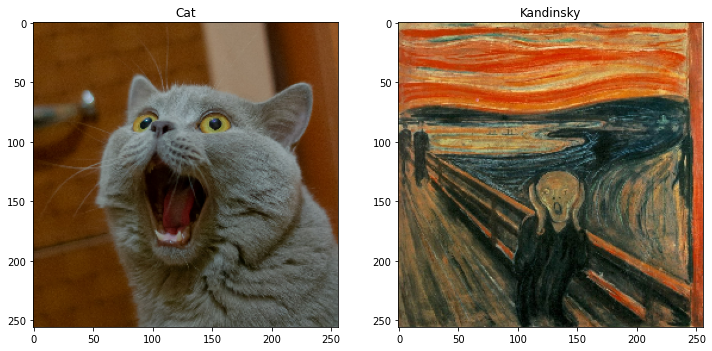

In [9]:
"""content_image=load_image(content_path)
style_image=load_image('/content/drive/MyDrive/data_mmai/starry_night.jpeg')

plt.subplot(1, 2, 1)
display_image(content_image, 'Content image')

plt.subplot(1, 2, 2)
display_image(style_image, 'Style Image')

"""

content_image=load_image('/content/drive/MyDrive/data_mmai/cat-its-mouth-open.jpeg')
style_image=load_image('/content/drive/MyDrive/data_mmai/the-scream.jpeg')

plain_cat = tf.expand_dims(content_image, axis=0)
munch_painting = tf.expand_dims(style_image, axis=0)

plt.subplot(121)
plt.title('Cat')
plt.imshow(plain_cat[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Kandinsky')
plt.imshow(munch_painting[0] * 0.5 + 0.5)

In [10]:
OUTPUT_CHANNELS = 3

generator_g = pix2pix.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')
generator_f = pix2pix.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')

discriminator_x = pix2pix.discriminator(norm_type='instancenorm', target=False)
discriminator_y = pix2pix.discriminator(norm_type='instancenorm', target=False)

In [11]:
LAMBDA = 10

loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [12]:
def discriminator_loss(real, generated):
  real_loss = loss_obj(tf.ones_like(real), real)

  generated_loss = loss_obj(tf.zeros_like(generated), generated)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss * 0.5

In [13]:
def generator_loss(generated):
  return loss_obj(tf.ones_like(generated), generated)

In [14]:
def calc_cycle_loss(real_image, cycled_image):
  loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))

  return LAMBDA * loss1

In [15]:
def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return LAMBDA * 0.5 * loss

In [16]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [17]:
checkpoint_path = "./checkpoints/train"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print ('Latest checkpoint restored!!')

In [18]:
EPOCHS = 40
def generate_images(model, test_input):
  prediction = model(test_input)

  plt.figure(figsize=(12, 12))

  display_list = [test_input[0], prediction[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

In [19]:
@tf.function
def train_step(real_x, real_y):
  # persistent is set to True because the tape is used more than
  # once to calculate the gradients.
  with tf.GradientTape(persistent=True) as tape:
    # Generator G translates X -> Y
    # Generator F translates Y -> X.

    fake_y = generator_g(real_x, training=True)
    cycled_x = generator_f(fake_y, training=True)

    fake_x = generator_f(real_y, training=True)
    cycled_y = generator_g(fake_x, training=True)

    # same_x and same_y are used for identity loss.
    same_x = generator_f(real_x, training=True)
    same_y = generator_g(real_y, training=True)

    disc_real_x = discriminator_x(real_x, training=True)
    disc_real_y = discriminator_y(real_y, training=True)

    disc_fake_x = discriminator_x(fake_x, training=True)
    disc_fake_y = discriminator_y(fake_y, training=True)

    # calculate the loss
    gen_g_loss = generator_loss(disc_fake_y)
    gen_f_loss = generator_loss(disc_fake_x)

    total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

    # Total generator loss = adversarial loss + cycle loss
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

  # Calculate the gradients for generator and discriminator
  generator_g_gradients = tape.gradient(total_gen_g_loss, 
                                        generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, 
                                        generator_f.trainable_variables)

  discriminator_x_gradients = tape.gradient(disc_x_loss, 
                                            discriminator_x.trainable_variables)
  discriminator_y_gradients = tape.gradient(disc_y_loss, 
                                            discriminator_y.trainable_variables)

  # Apply the gradients to the optimizer
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients, 
                                            generator_g.trainable_variables))

  generator_f_optimizer.apply_gradients(zip(generator_f_gradients, 
                                            generator_f.trainable_variables))

  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,
                                                discriminator_x.trainable_variables))

  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,
                                                discriminator_y.trainable_variables))

.

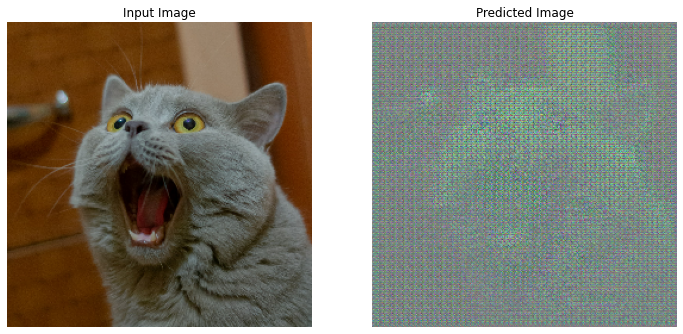

Time taken for epoch 1 is 43.1879460811615 sec

.

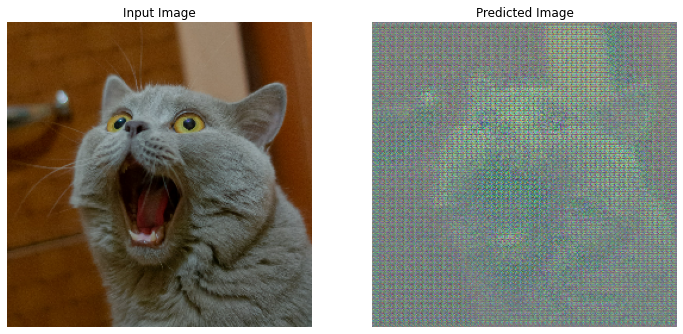

Time taken for epoch 2 is 10.829622030258179 sec

.

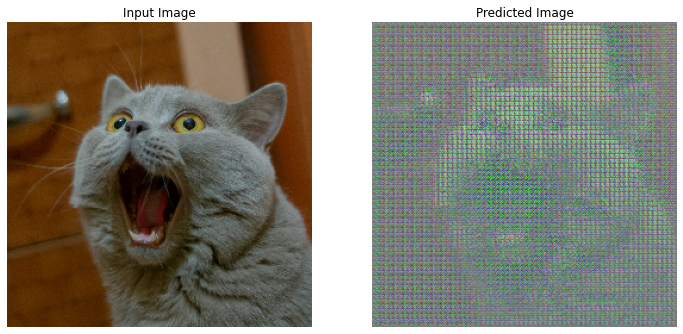

Time taken for epoch 3 is 9.753134965896606 sec

.

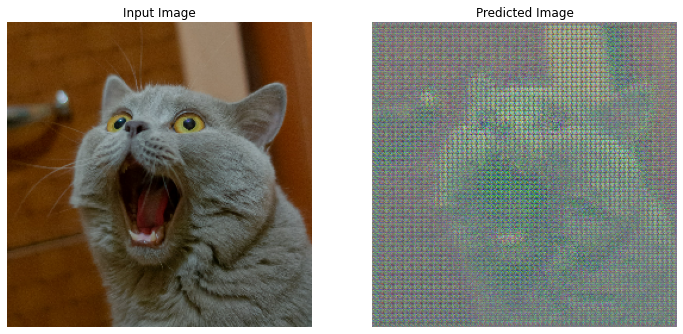

Time taken for epoch 4 is 9.783124446868896 sec

.

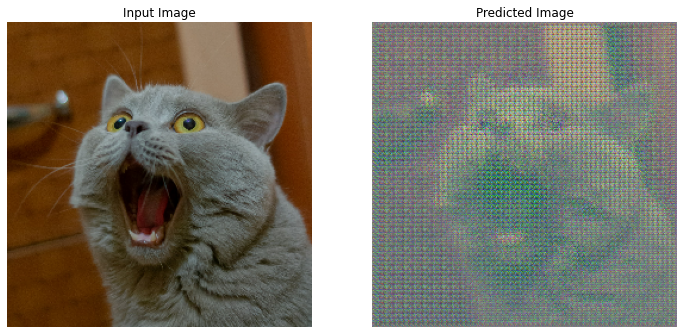

Saving checkpoint for epoch 5 at ./checkpoints/train/ckpt-1
Time taken for epoch 5 is 28.076174020767212 sec

.

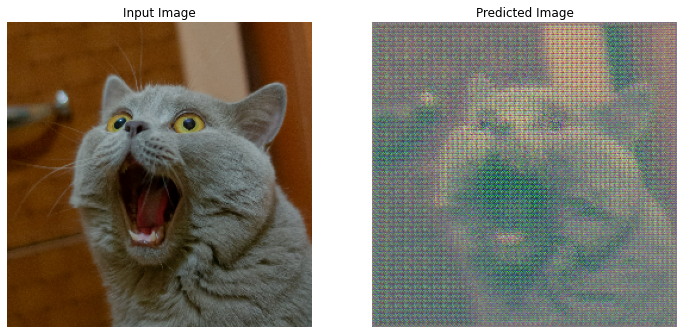

Time taken for epoch 6 is 13.701491355895996 sec

.

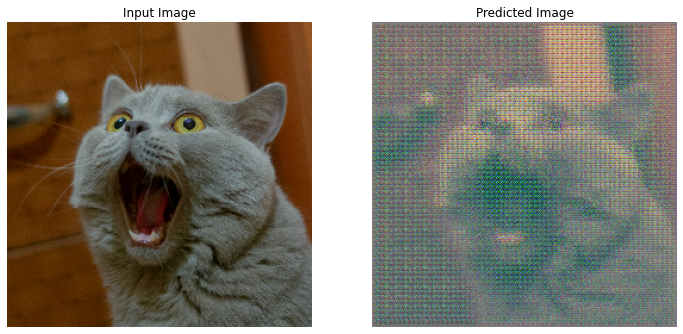

Time taken for epoch 7 is 9.829505443572998 sec

.

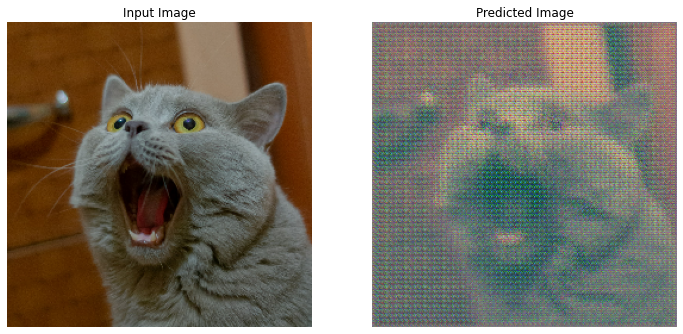

Time taken for epoch 8 is 9.8470458984375 sec

.

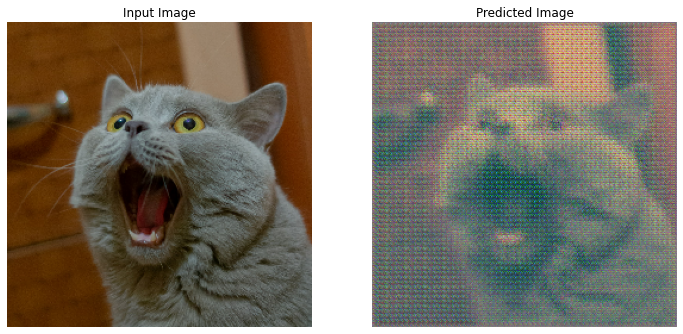

Time taken for epoch 9 is 9.751976013183594 sec

.

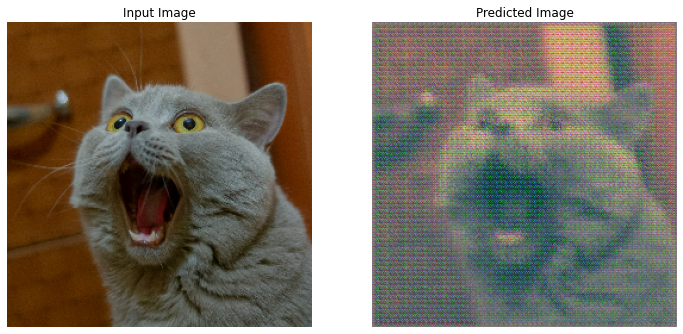

Saving checkpoint for epoch 10 at ./checkpoints/train/ckpt-2
Time taken for epoch 10 is 15.526768922805786 sec

.

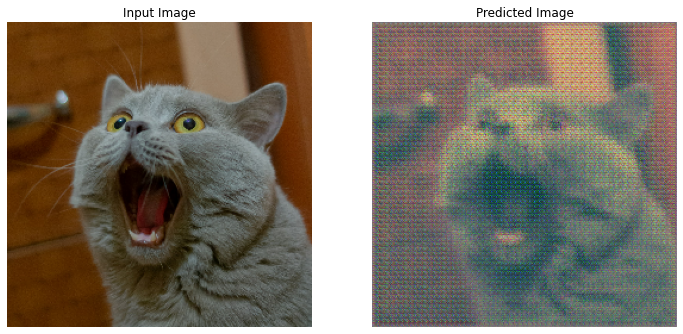

Time taken for epoch 11 is 9.741688966751099 sec

.

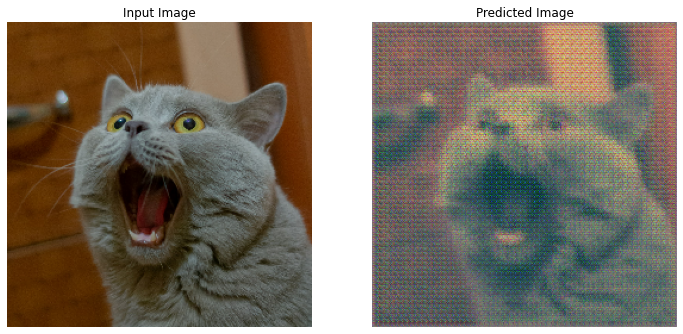

Time taken for epoch 12 is 9.96570086479187 sec

.

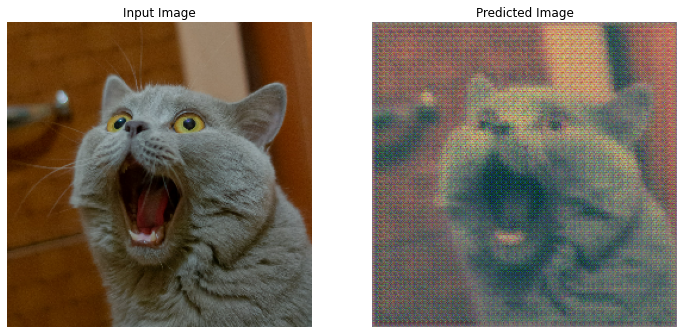

Time taken for epoch 13 is 9.956608057022095 sec

.

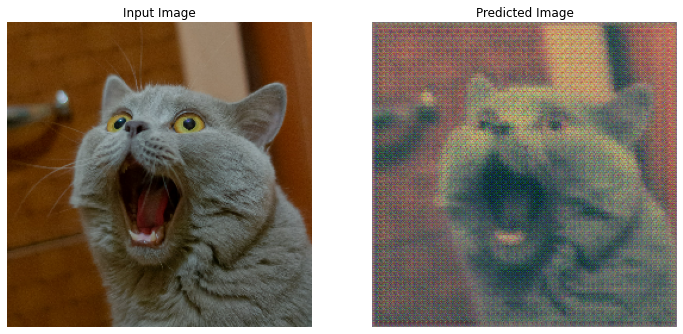

Time taken for epoch 14 is 10.14122748374939 sec

.

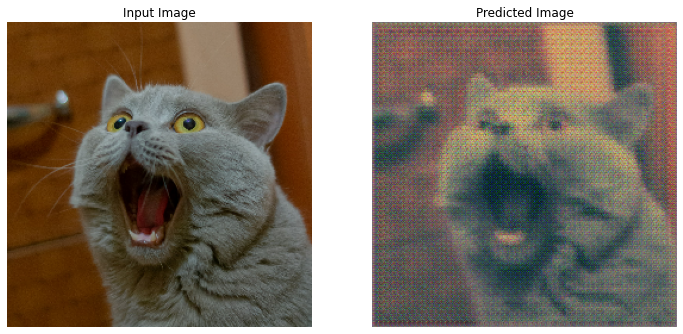

Saving checkpoint for epoch 15 at ./checkpoints/train/ckpt-3
Time taken for epoch 15 is 18.14676284790039 sec

.

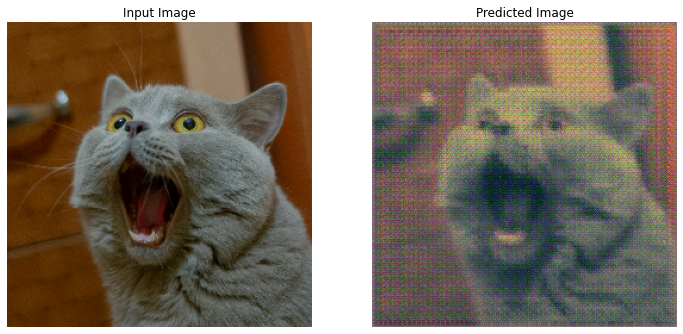

Time taken for epoch 16 is 10.97034740447998 sec

.

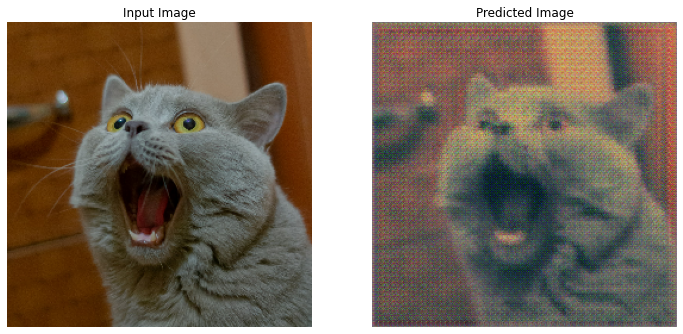

Time taken for epoch 17 is 10.032549142837524 sec

.

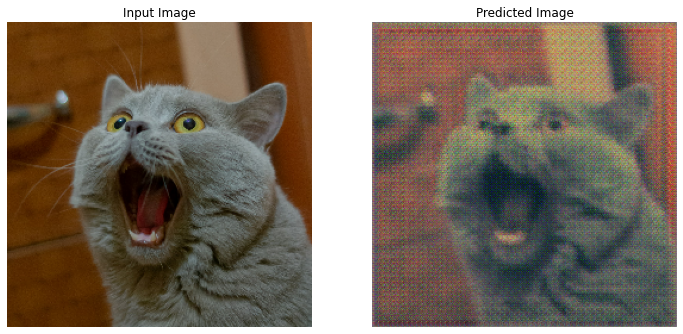

Time taken for epoch 18 is 15.575027227401733 sec

.

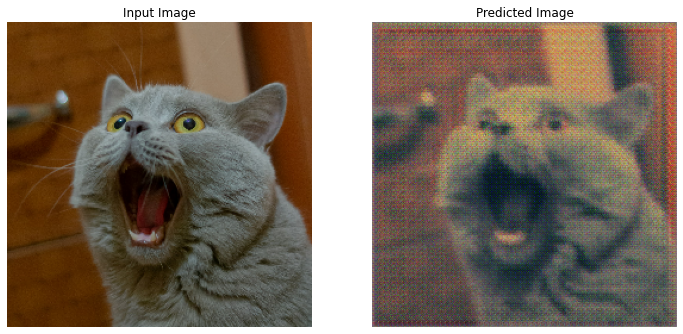

Time taken for epoch 19 is 9.985916376113892 sec

.

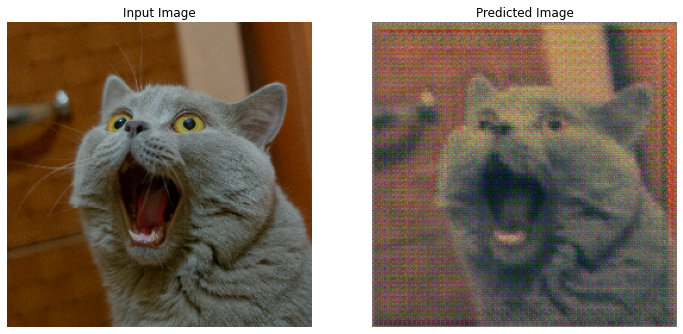

Saving checkpoint for epoch 20 at ./checkpoints/train/ckpt-4
Time taken for epoch 20 is 15.60059404373169 sec

.

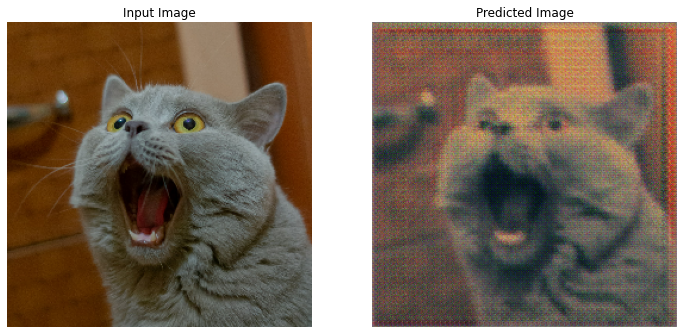

Time taken for epoch 21 is 10.138648986816406 sec

.

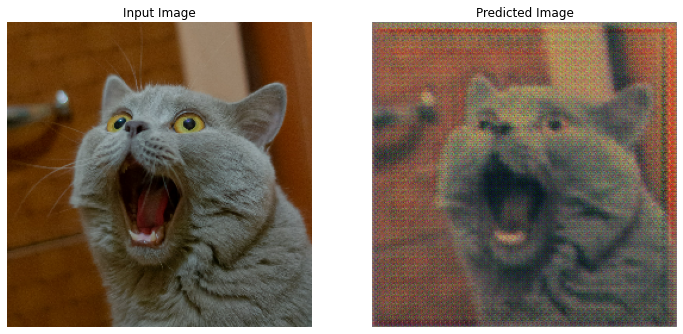

Time taken for epoch 22 is 10.21302056312561 sec

.

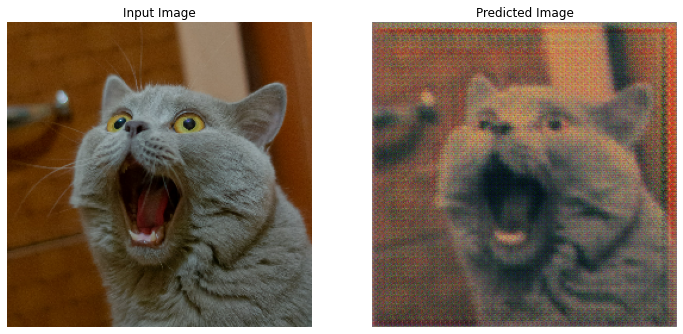

Time taken for epoch 23 is 10.172152519226074 sec

.

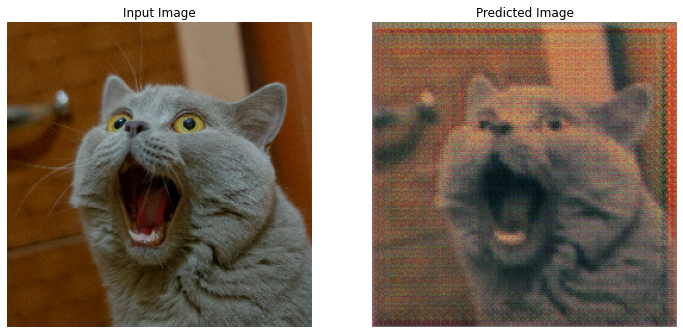

Time taken for epoch 24 is 10.182103157043457 sec

.

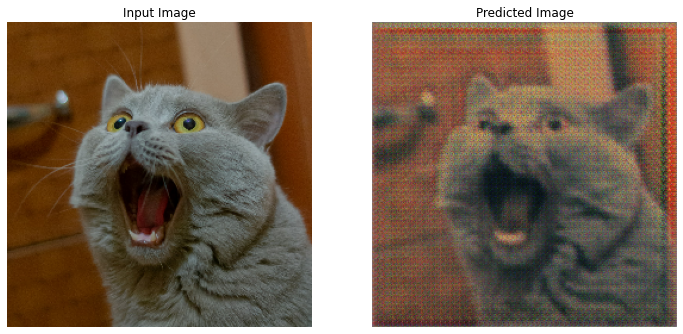

Saving checkpoint for epoch 25 at ./checkpoints/train/ckpt-5
Time taken for epoch 25 is 15.399919271469116 sec

.

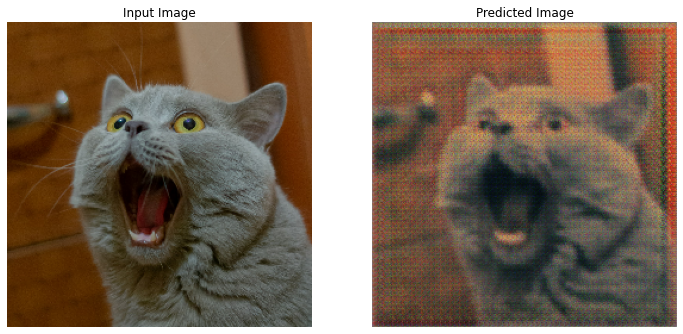

Time taken for epoch 26 is 10.066912174224854 sec

.

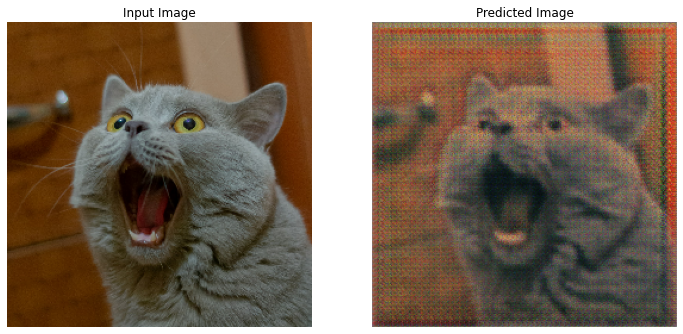

Time taken for epoch 27 is 10.087989330291748 sec

.

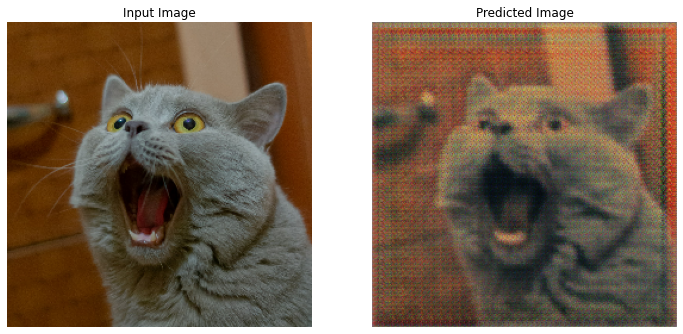

Time taken for epoch 28 is 9.977941036224365 sec

.

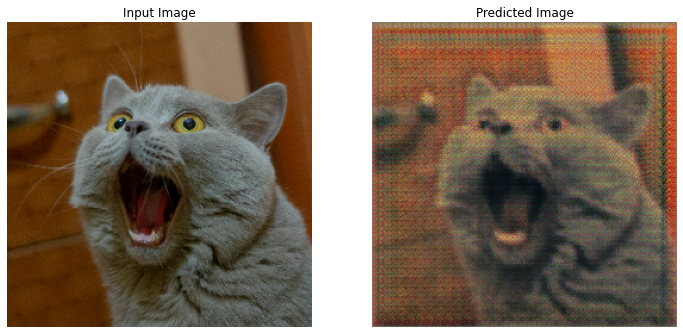

Time taken for epoch 29 is 10.1651451587677 sec

.

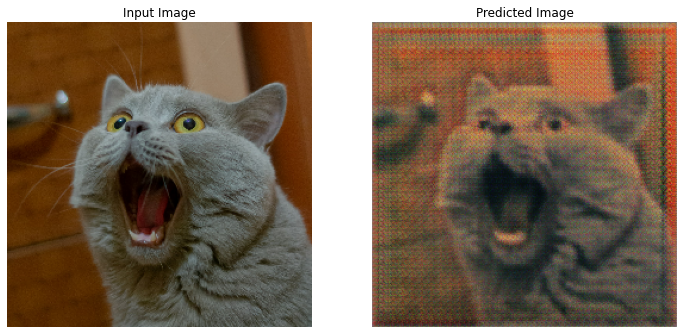

Saving checkpoint for epoch 30 at ./checkpoints/train/ckpt-6
Time taken for epoch 30 is 15.104544639587402 sec

.

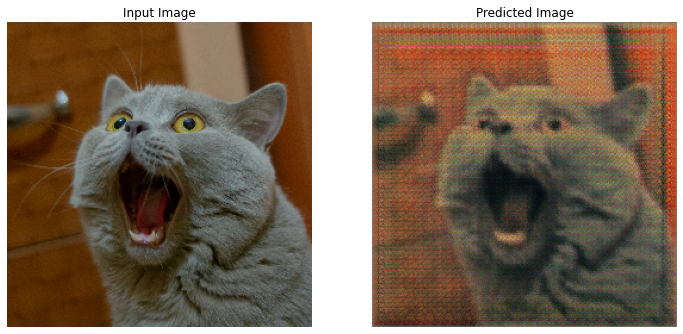

Time taken for epoch 31 is 10.511184930801392 sec

.

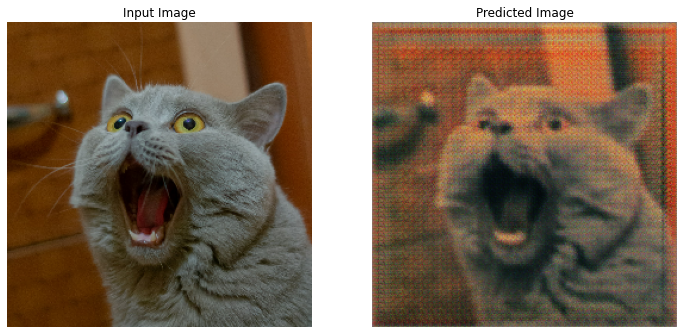

Time taken for epoch 32 is 10.194393873214722 sec

.

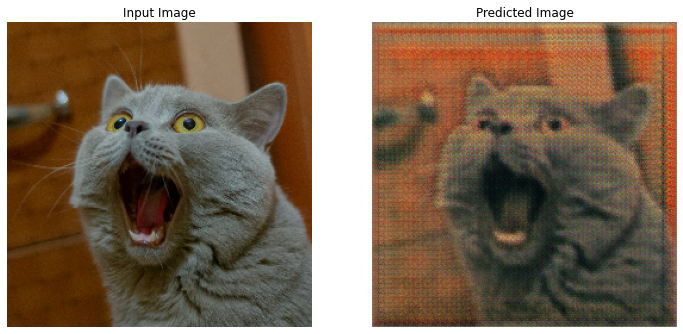

Time taken for epoch 33 is 10.168474435806274 sec

.

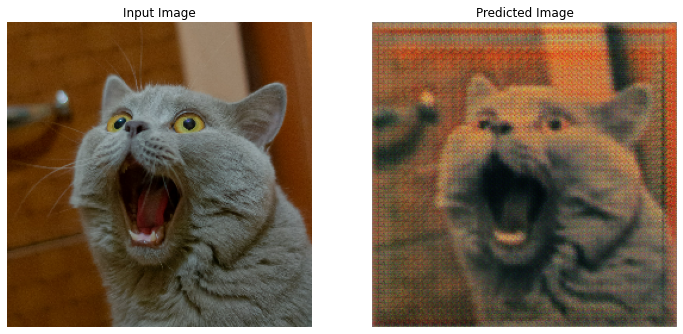

Time taken for epoch 34 is 10.420042514801025 sec

.

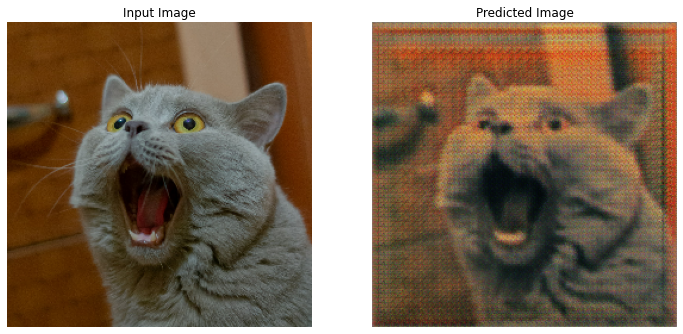

Saving checkpoint for epoch 35 at ./checkpoints/train/ckpt-7
Time taken for epoch 35 is 16.166812896728516 sec

.

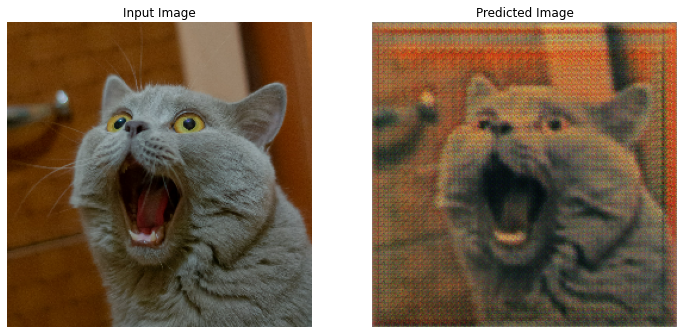

Time taken for epoch 36 is 9.931594133377075 sec

.

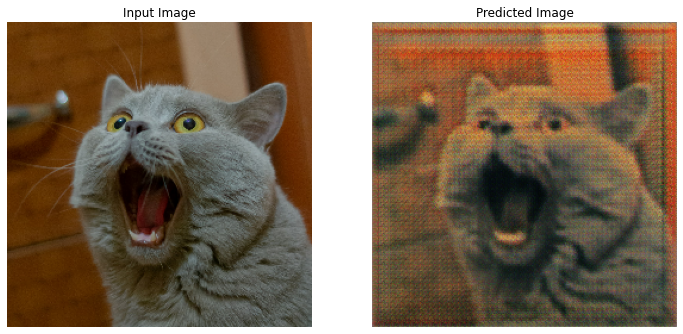

Time taken for epoch 37 is 10.15888500213623 sec

.

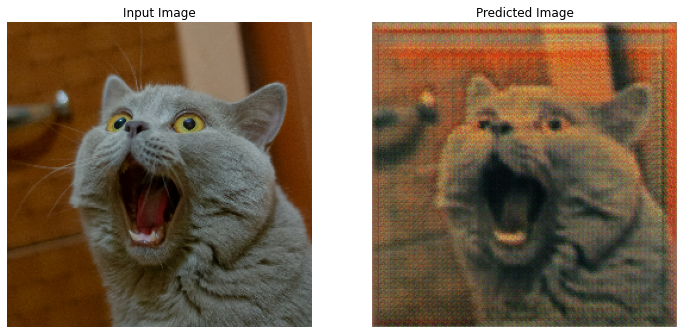

Time taken for epoch 38 is 10.109804630279541 sec

.

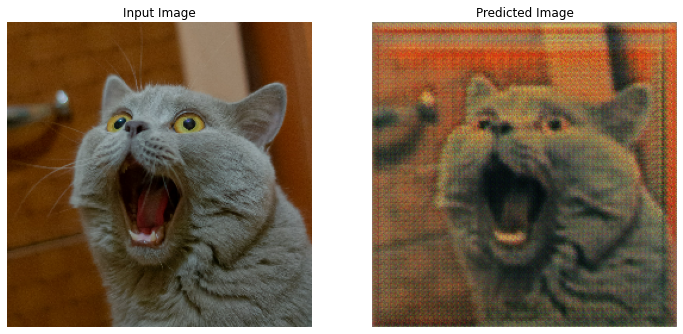

Time taken for epoch 39 is 10.121355772018433 sec

.

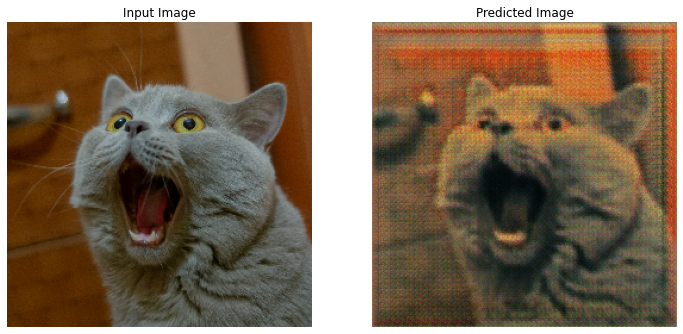

Saving checkpoint for epoch 40 at ./checkpoints/train/ckpt-8
Time taken for epoch 40 is 15.090291738510132 sec



In [20]:
for epoch in range(EPOCHS):
  start = time.time()

  n = 0
  train_step(plain_cat, munch_painting)
  if n % 10 == 0:
    print ('.', end='')
  n += 1

  # clear_output(wait=True)
  # Using a consistent image (sample_horse) so that the progress of the model
  # is clearly visible.
  generate_images(generator_g, plain_cat)

  if (epoch + 1) % 5 == 0:
    ckpt_save_path = ckpt_manager.save()
    print ('Saving checkpoint for epoch {} at {}'.format(epoch+1,
                                                         ckpt_save_path))

  print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                      time.time()-start))

In [21]:
# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print ('Latest checkpoint restored!!')

Latest checkpoint restored!!


.

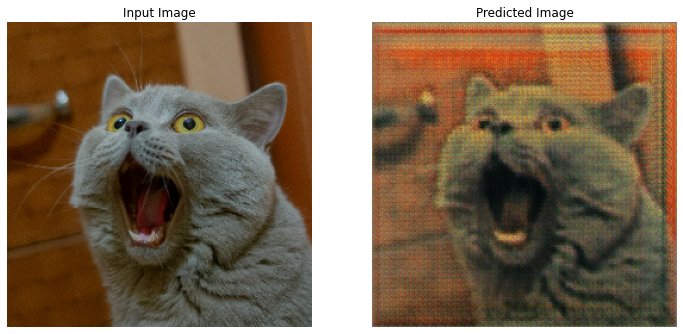

Time taken for epoch 1 is 12.369561195373535 sec

.

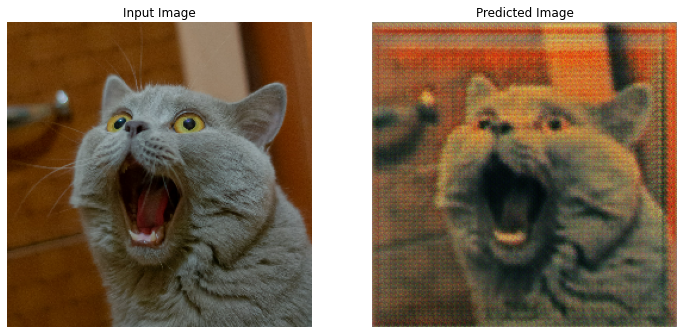

Time taken for epoch 2 is 13.33230972290039 sec

.

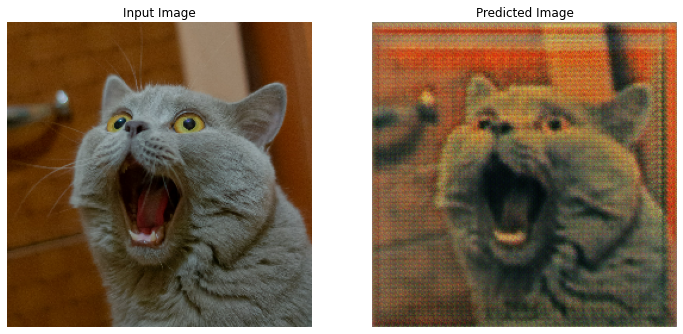

Time taken for epoch 3 is 9.762686491012573 sec

.

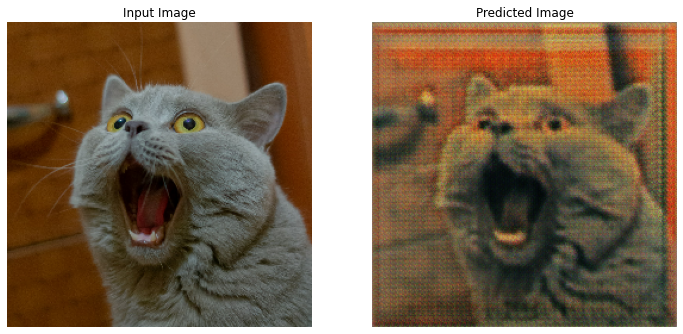

Time taken for epoch 4 is 9.780993700027466 sec

.

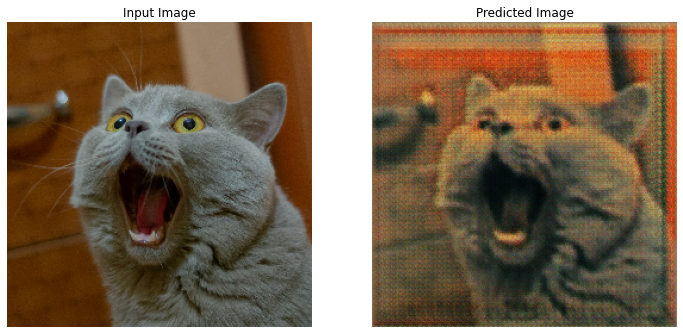

Saving checkpoint for epoch 5 at ./checkpoints/train/ckpt-9
Time taken for epoch 5 is 15.858173847198486 sec

.

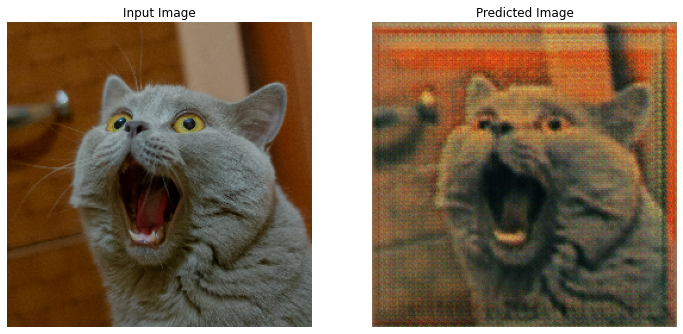

Time taken for epoch 6 is 11.901736974716187 sec

.

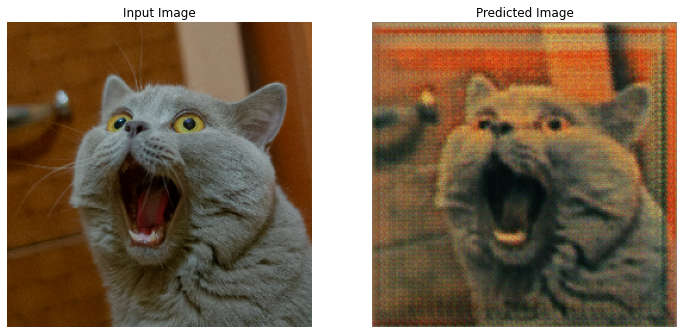

Time taken for epoch 7 is 11.827605962753296 sec

.

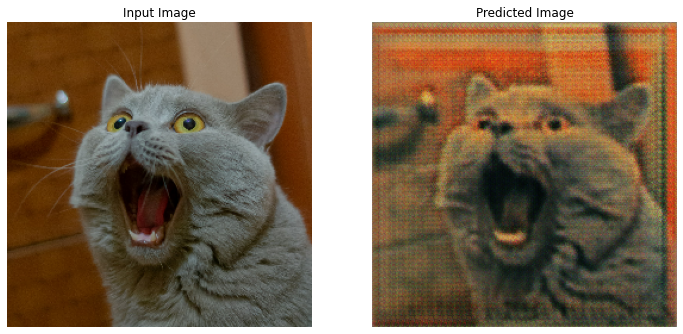

Time taken for epoch 8 is 11.689570665359497 sec

.

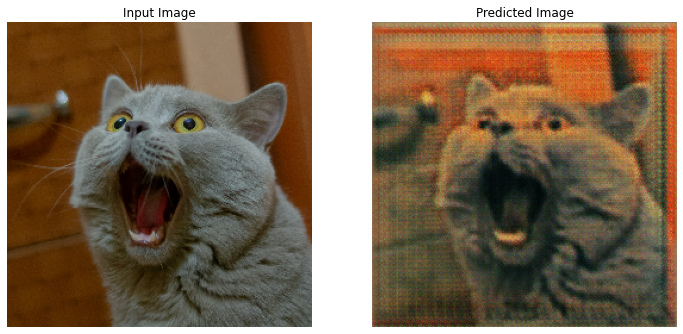

Time taken for epoch 9 is 10.862332344055176 sec

.

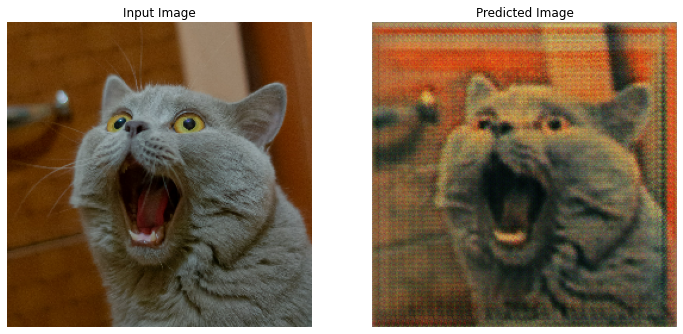

Saving checkpoint for epoch 10 at ./checkpoints/train/ckpt-10
Time taken for epoch 10 is 14.592645168304443 sec

.

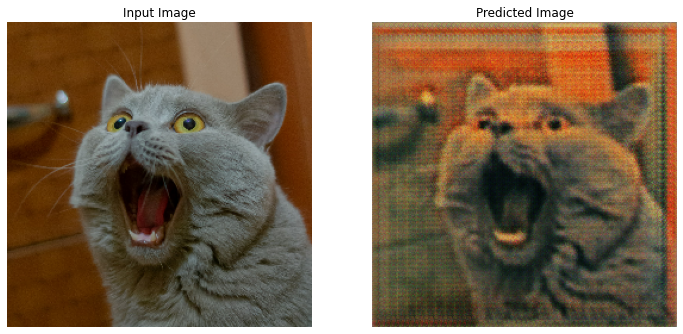

Time taken for epoch 11 is 9.786465644836426 sec

.

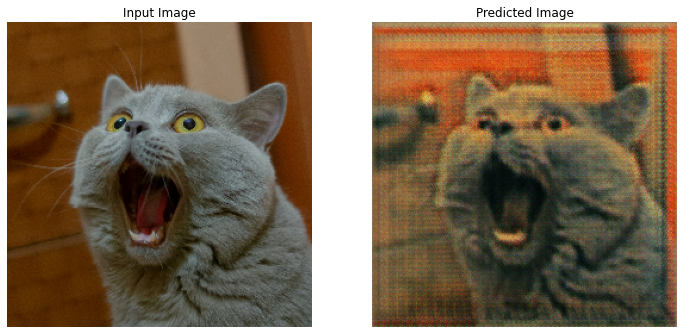

Time taken for epoch 12 is 9.868152618408203 sec

.

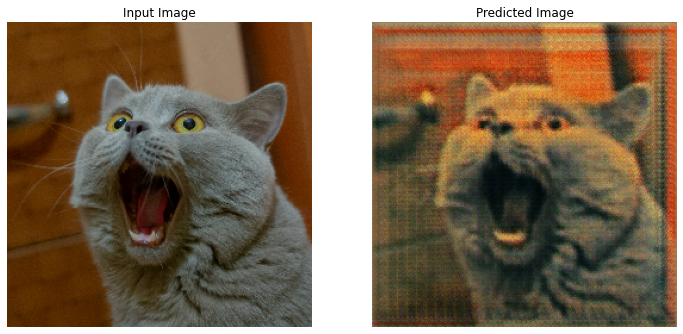

Time taken for epoch 13 is 9.958094358444214 sec

.

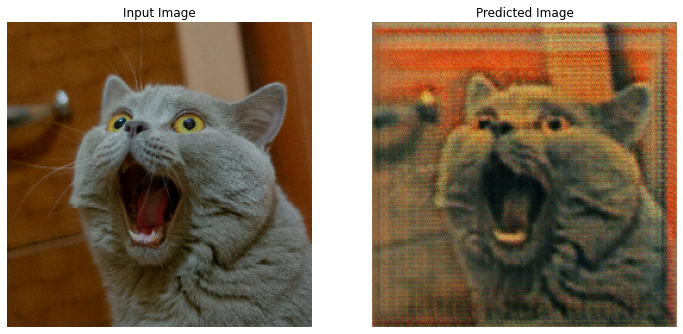

Time taken for epoch 14 is 9.907655715942383 sec

.

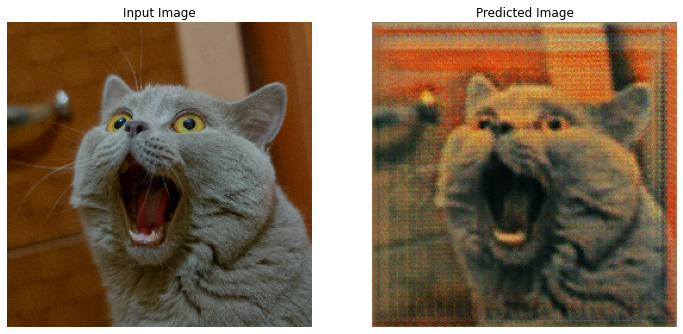

Saving checkpoint for epoch 15 at ./checkpoints/train/ckpt-11
Time taken for epoch 15 is 14.73123288154602 sec

.

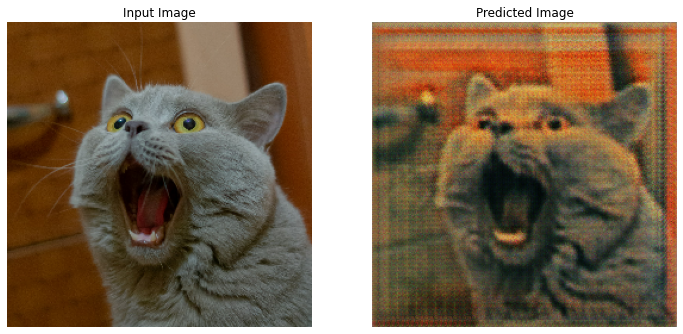

Time taken for epoch 16 is 10.38550877571106 sec

.

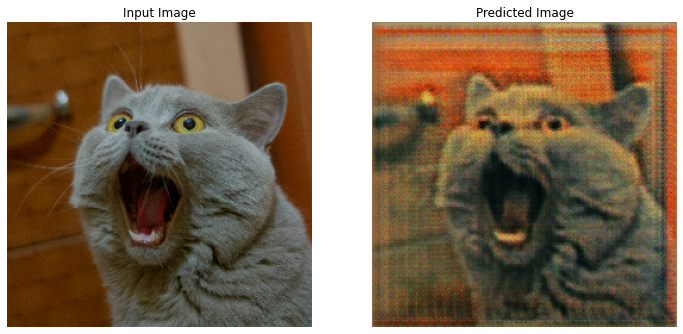

Time taken for epoch 17 is 10.214922428131104 sec

.

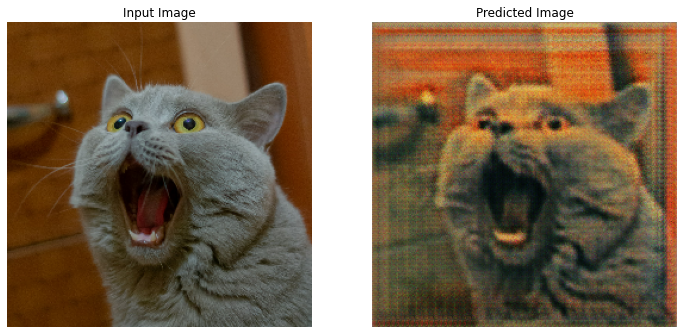

Time taken for epoch 18 is 10.264993906021118 sec

.

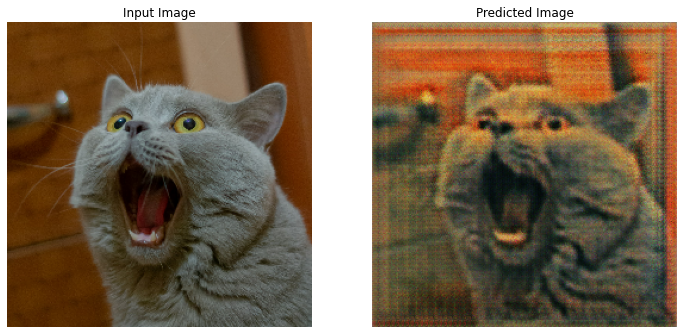

Time taken for epoch 19 is 10.182279586791992 sec

.

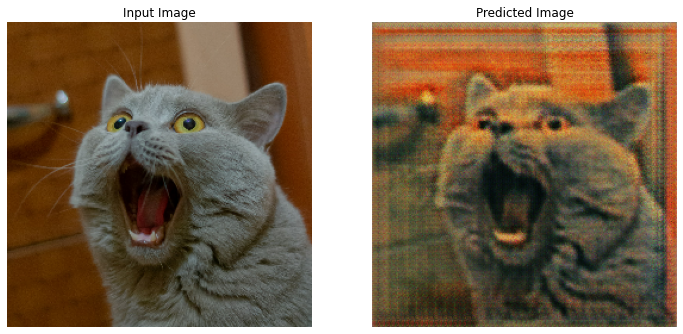

Saving checkpoint for epoch 20 at ./checkpoints/train/ckpt-12
Time taken for epoch 20 is 15.85867714881897 sec

.

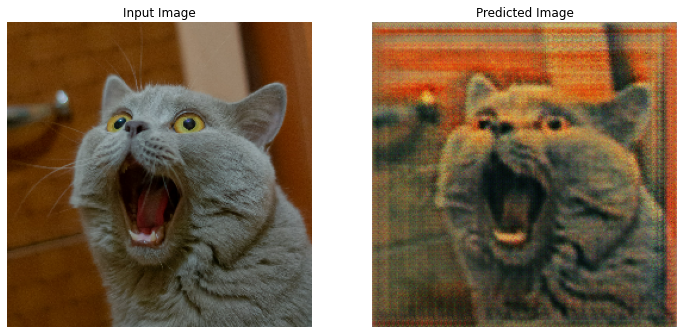

Time taken for epoch 21 is 10.010050058364868 sec

.

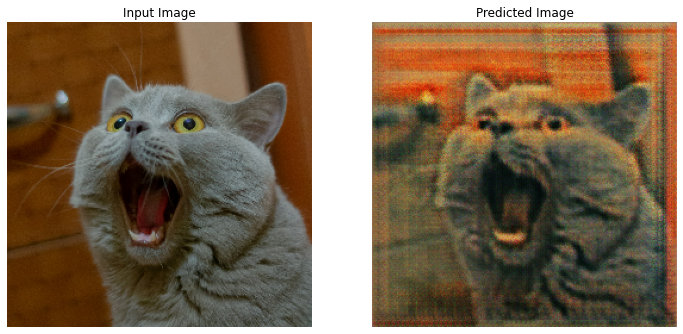

Time taken for epoch 22 is 9.94742751121521 sec

.

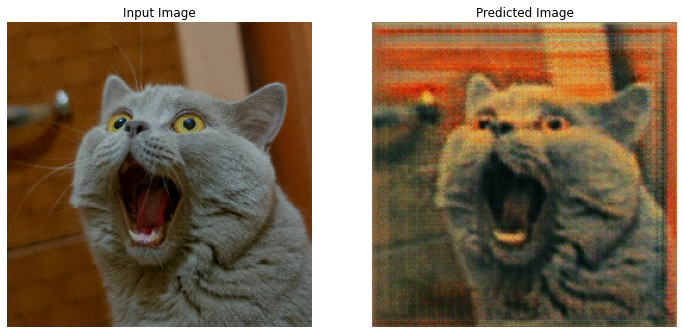

Time taken for epoch 23 is 9.904014587402344 sec

.

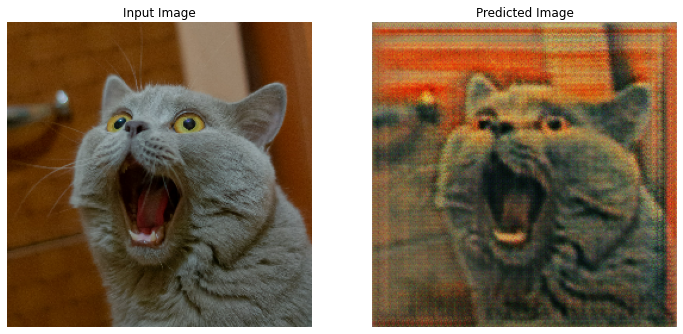

Time taken for epoch 24 is 9.929426670074463 sec

.

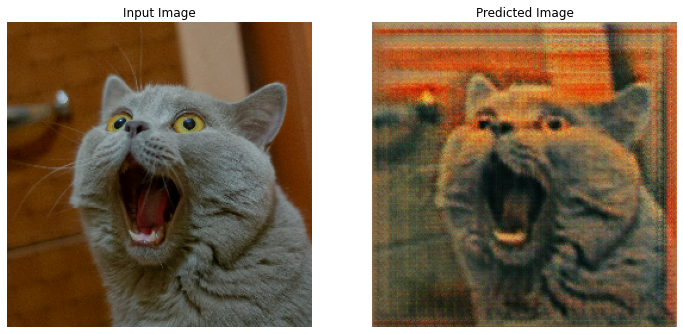

Saving checkpoint for epoch 25 at ./checkpoints/train/ckpt-13
Time taken for epoch 25 is 14.969737768173218 sec

.

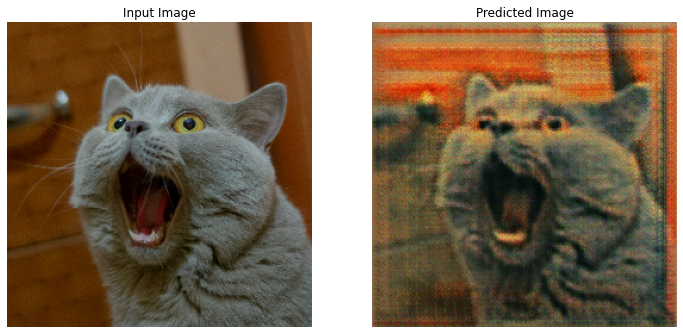

Time taken for epoch 26 is 9.998231649398804 sec

.

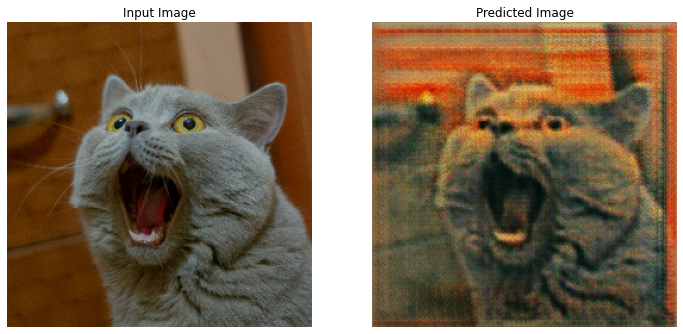

Time taken for epoch 27 is 10.03406834602356 sec

.

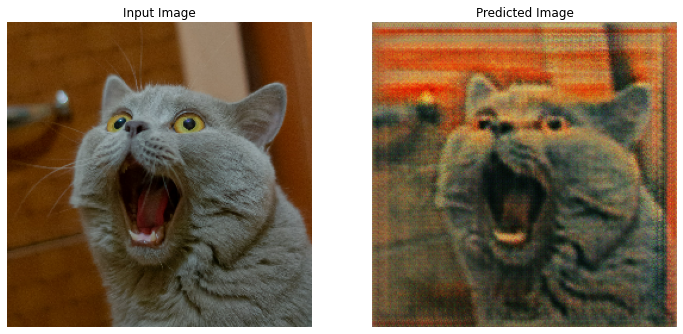

Time taken for epoch 28 is 10.253860235214233 sec

.

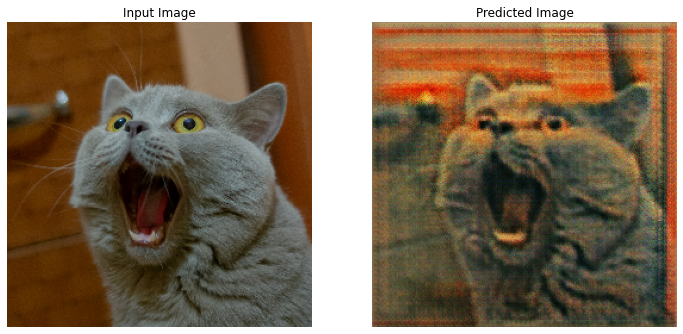

Time taken for epoch 29 is 10.360463380813599 sec

.

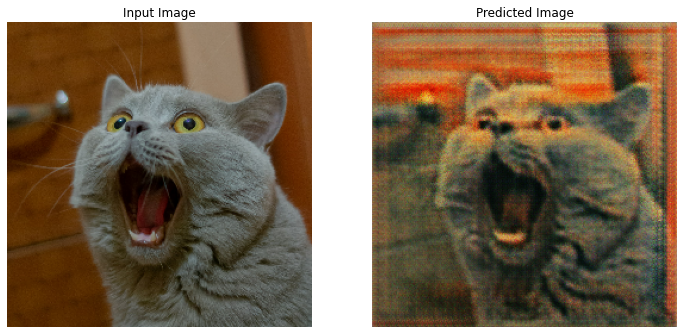

Saving checkpoint for epoch 30 at ./checkpoints/train/ckpt-14
Time taken for epoch 30 is 20.352965116500854 sec

.

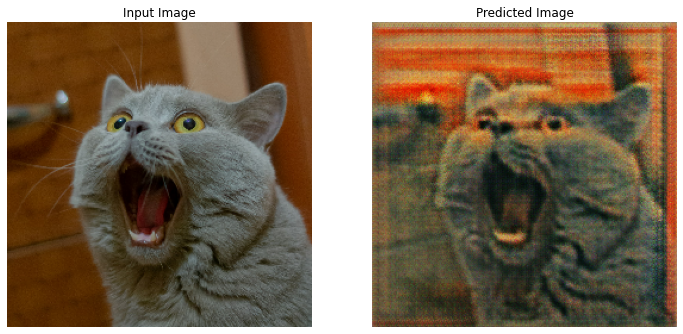

Time taken for epoch 31 is 11.06498408317566 sec

.

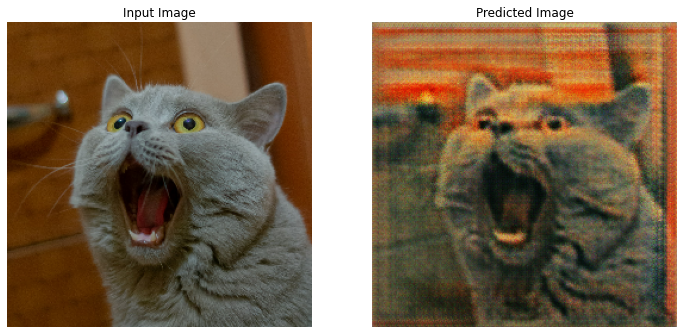

Time taken for epoch 32 is 10.35688042640686 sec

.

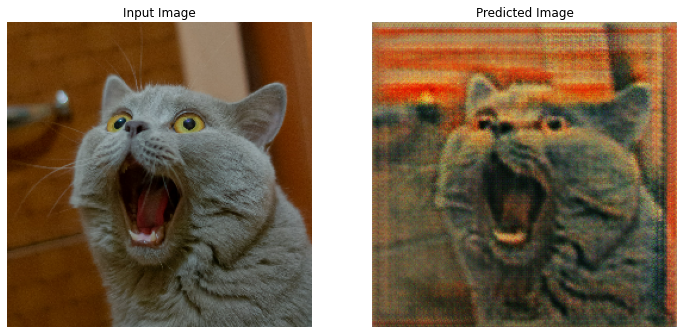

Time taken for epoch 33 is 10.156331777572632 sec

.

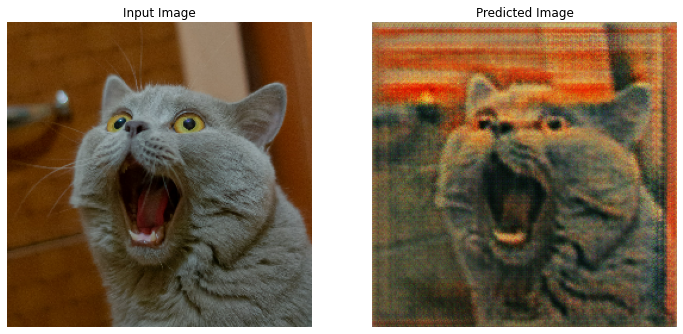

Time taken for epoch 34 is 10.115163803100586 sec

.

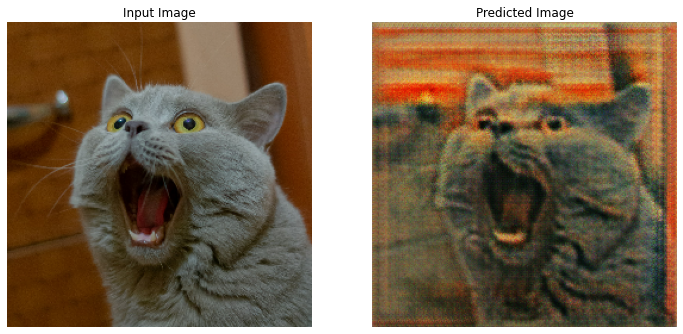

Saving checkpoint for epoch 35 at ./checkpoints/train/ckpt-15
Time taken for epoch 35 is 15.172003746032715 sec

.

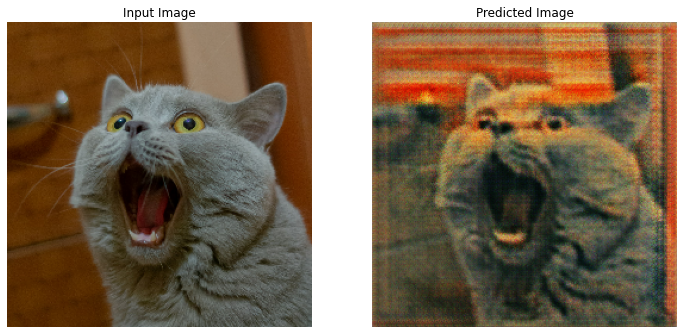

Time taken for epoch 36 is 10.053743362426758 sec

.

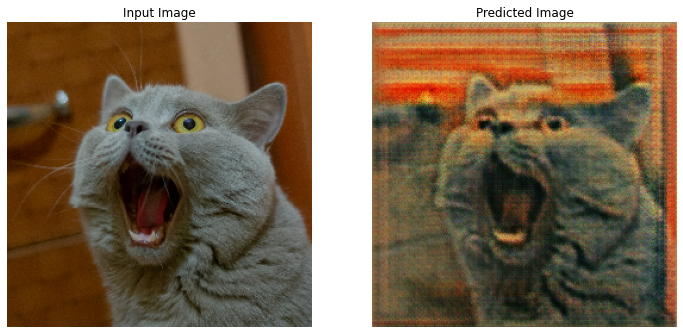

Time taken for epoch 37 is 10.094550132751465 sec

.

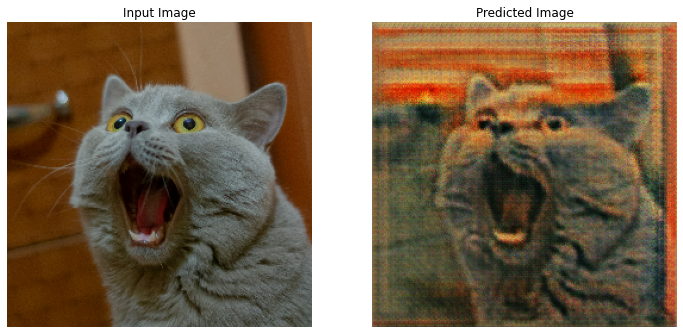

Time taken for epoch 38 is 10.237470388412476 sec

.

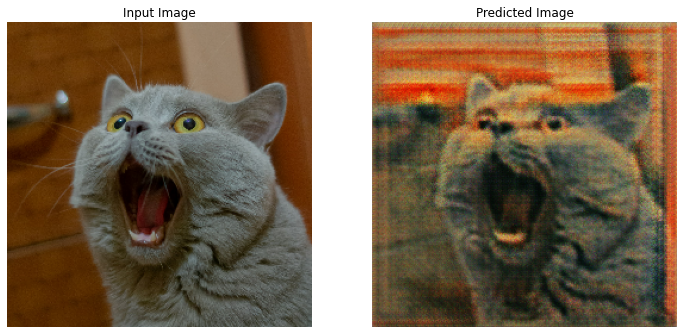

Time taken for epoch 39 is 10.197819948196411 sec

.

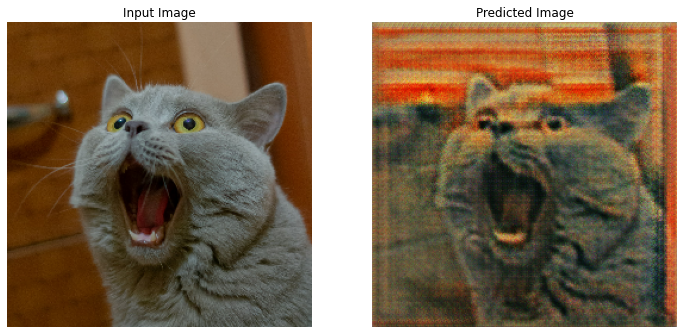

Saving checkpoint for epoch 40 at ./checkpoints/train/ckpt-16
Time taken for epoch 40 is 14.843485832214355 sec



In [22]:
for epoch in range(EPOCHS):
  start = time.time()

  n = 0
  train_step(plain_cat, munch_painting)
  if n % 10 == 0:
    print ('.', end='')
  n += 1

  # clear_output(wait=True)
  # Using a consistent image (sample_horse) so that the progress of the model
  # is clearly visible.
  generate_images(generator_g, plain_cat)

  if (epoch + 1) % 5 == 0:
    ckpt_save_path = ckpt_manager.save()
    print ('Saving checkpoint for epoch {} at {}'.format(epoch+1,
                                                         ckpt_save_path))

  print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                      time.time()-start))